In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.rcParams['font.sans-serif']=['SimHei'] #显示中文标签
plt.rcParams['axes.unicode_minus']=False   #这两行需要手动设置
import xarray as xr
ds = xr.open_dataset(r'D:/software/Python/PythonProject/seamounts_edge_detection/sample/data/GEBCO_2023.nc')
print(ds)

<xarray.Dataset>
Dimensions:    (lon: 86400, lat: 43200)
Coordinates:
  * lon        (lon) float64 -180.0 -180.0 -180.0 -180.0 ... 180.0 180.0 180.0
  * lat        (lat) float64 -90.0 -89.99 -89.99 -89.99 ... 89.99 89.99 90.0
Data variables:
    crs        |S1 ...
    elevation  (lat, lon) int16 ...
Attributes: (12/36)
    title:                           The GEBCO_2023 Grid - a continuous terra...
    summary:                         The GEBCO_2023 Grid is a continuous, glo...
    keywords:                        BATHYMETRY/SEAFLOOR TOPOGRAPHY, DIGITAL ...
    Conventions:                     CF-1.6, ACDD-1.3
    id:                              DOI: 10.5285/f98b053b-0cbc-6c23-e053-6c8...
    naming_authority:                https://dx.doi.org
    ...                              ...
    geospatial_vertical_units:       meters
    geospatial_vertical_resolution:  1.0
    geospatial_vertical_positive:    up
    identifier_product_doi:          DOI: 10.5285/f98b053b-0cbc-6c23-e053-6c8..

(5000, 5000)
<xarray.DataArray 'elevation' (lat: 5000, lon: 5000)>
array([[-4172, -4169, -4175, ..., -5928, -5941, -5970],
       [-4169, -4169, -4178, ..., -5916, -5929, -5959],
       [-4175, -4171, -4179, ..., -5904, -5918, -5948],
       ...,
       [-5789, -5789, -5789, ..., -5317, -5286, -5261],
       [-5796, -5796, -5794, ..., -5296, -5278, -5264],
       [-5798, -5798, -5797, ..., -5279, -5268, -5261]], dtype=int16)
Coordinates:
  * lon      (lon) float64 159.2 159.2 159.2 159.2 ... 180.0 180.0 180.0 180.0
  * lat      (lat) float64 5.835 5.84 5.844 5.848 ... 26.65 26.66 26.66 26.66
Attributes:
    standard_name:       height_above_mean_sea_level
    long_name:           Elevation relative to sea level
    units:               m
    grid_mapping:        crs
    sdn_parameter_urn:   SDN:P01::ALATZZ01
    sdn_parameter_name:  Sea floor height (above mean sea level) {bathymetric...
    sdn_uom_urn:         SDN:P06::ULAA
    sdn_uom_name:        Metres


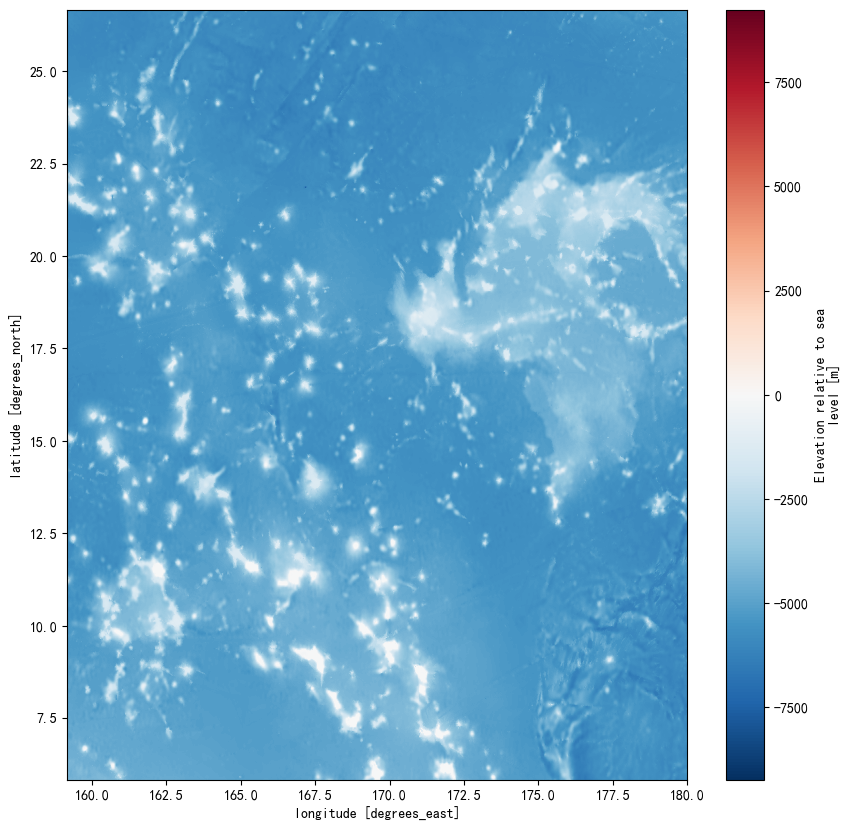

In [61]:
plt.figure(figsize=(10, 10))
da = ds['elevation'].load()
top_left_da = da.isel(lat=slice(23000, 28000), lon=slice(81400, 86400)) #设定好整体的范围
# Now you can perform operations on this subset
# For example, to load this subset into memory, you would call .load()
top_left_da_loaded = top_left_da.load()
top_left_da_loaded.plot()       #5000, 5000
# plt.savefig('high_res_plot.png', dpi=2000)
print(top_left_da_loaded)
plt.show()

(5000, 5000)
(5000, 5000, 4)


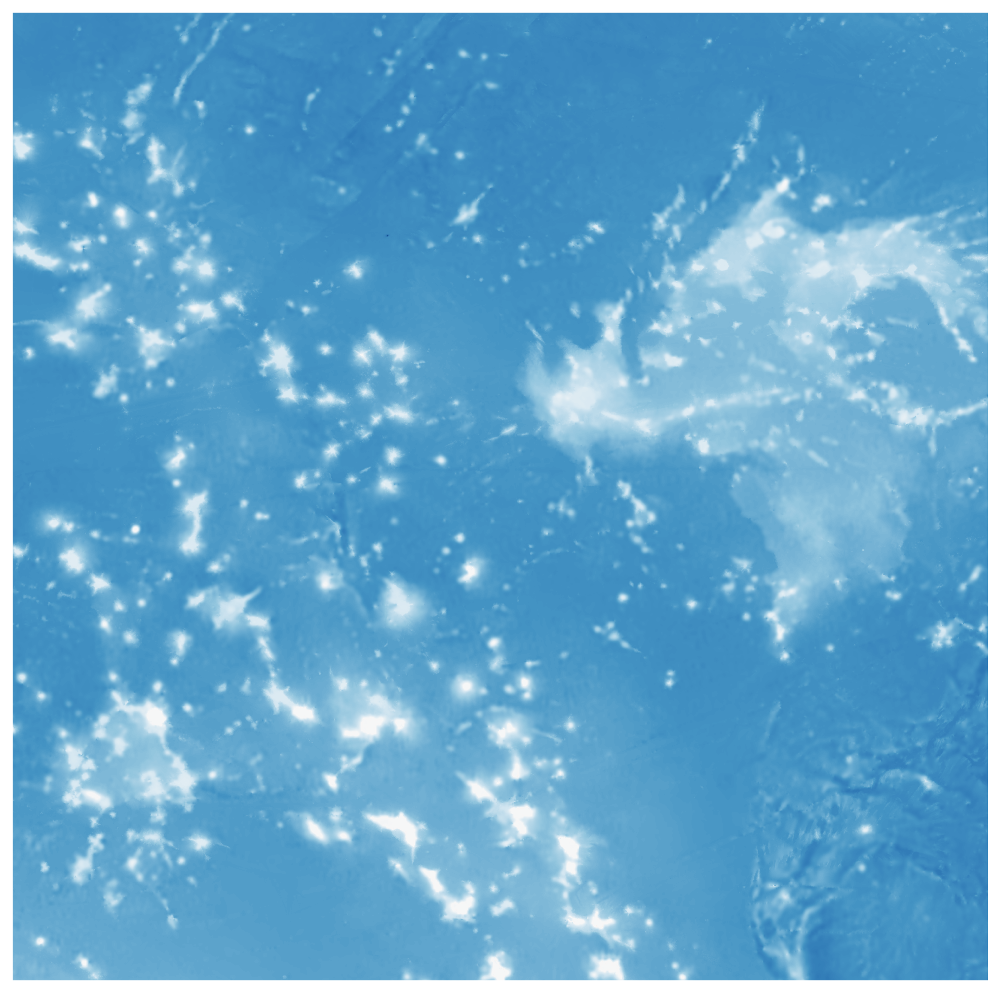

In [65]:
import cv2 
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas

# Your data plotting code remains the same
# ...

# The desired dpi is calculated based on the original image size and the figure size
original_size = 5000  # Assuming the original size is 5000x5000 pixels
fig_size = 10  # The figure size is 10x10 inches
desired_dpi = original_size / fig_size

# Create a figure with the desired dpi
fig, ax = plt.subplots(figsize=(fig_size, fig_size), dpi=desired_dpi)
top_left_da_loaded.plot(ax=ax, add_colorbar=False)
print(top_left_da_loaded.shape)
ax.axis('off')

# Convert the Matplotlib figure to a NumPy array
canvas = FigureCanvas(fig)
canvas.draw()
image = np.array(canvas.renderer.buffer_rgba())
print(image.shape)

# OpenCV uses BGR color order, but matplotlib uses RGBA
image = cv2.cvtColor(image, cv2.COLOR_RGBA2BGR)

# Now 'image' is an array that can be processed by OpenCV
# For example, you can save the image using OpenCV
# cv2.imwrite('high_res_plot_opencv.png', image)


(5000, 5000)


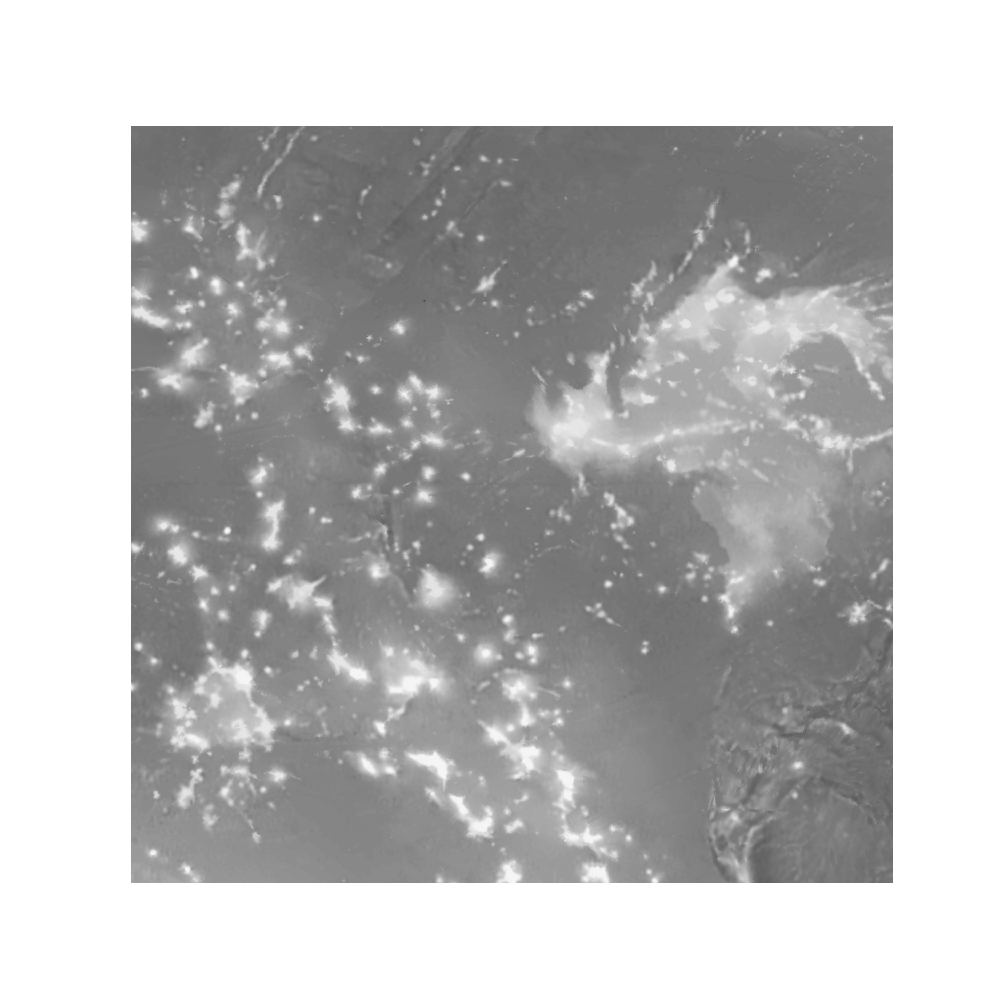

In [70]:
import matplotlib.pyplot as plt
gray=cv2.cvtColor(image,cv2.COLOR_BGRA2GRAY)
print(gray.shape)
fig, ax = plt.subplots(figsize=(15, 15),dpi=desired_dpi)
plt.imshow(gray,cmap='gray')
plt.axis('off')
plt.show()

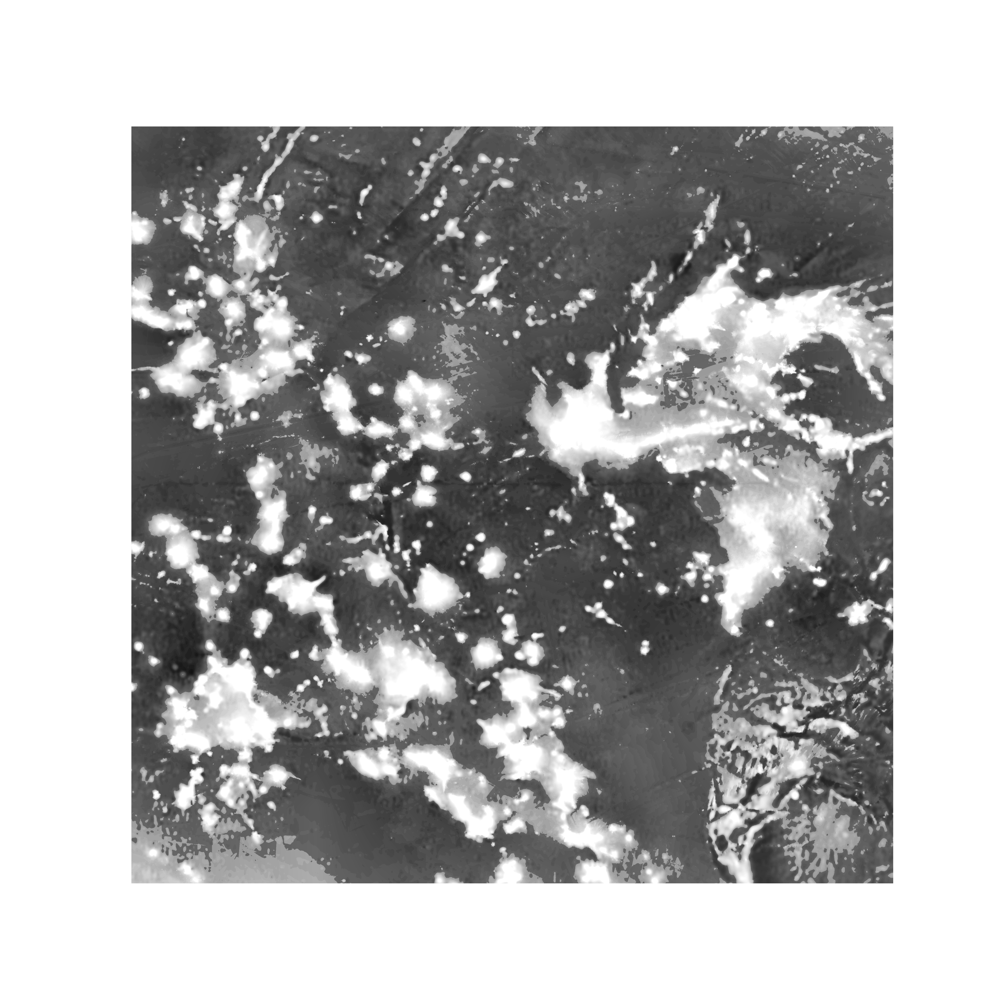

In [71]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure
def threshold_enhance(image, threshold, increase_factor, decrease_factor):
    """
    对图像应用阈值增强，使亮的地方更亮，暗的地方更暗。

    参数:
    image: 输入的灰度图像。
    threshold: 用于区分亮区和暗区的阈值。
    increase_factor: 亮区的增强因子。
    decrease_factor: 暗区的减弱因子。
    """
    # 复制图像以保留原始数据
    enhanced_image = np.copy(image)

    # 增强亮区
    bright_areas = image > threshold
    enhanced_image[bright_areas] = np.clip(enhanced_image[bright_areas] * increase_factor, 0, 255)

    # 减弱暗区
    dark_areas = image <= threshold
    enhanced_image[dark_areas] = np.clip(enhanced_image[dark_areas] * decrease_factor, 0, 255)

    return enhanced_image
# Load the image
# image_path = '/mnt/data/high_res_plot.png'
# image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
# Check if the image has an alpha channel (transparency)
if image.shape[2] == 4:
    # Convert the image from BGR to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGRA2RGBA)
else:
    # Convert the image from BGR to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
# Convert image to grayscale
image_gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
# Apply histogram equalization to enhance contrast
image_eq = exposure.equalize_adapthist(image_gray, clip_limit=0.03)
# Convert the image back to uint8
image_eq_uint8 = (image_eq * 255).astype(np.uint8)
# 应用阈值增强算法
threshold = 128  # 可以根据需要调整这个阈值
increase_factor = 1.2  # 增强因子，使亮区变得更亮
decrease_factor = 0.8  # 减弱因子，使暗区变得更暗
enhanced_image = threshold_enhance(image_eq_uint8, threshold, increase_factor, decrease_factor)
# Display the processed image
fig, ax = plt.subplots(figsize=(15, 15),dpi=desired_dpi)
plt.imshow(enhanced_image, cmap='gray')
plt.axis('off')  # Hide the axes
plt.show()

(5000, 5000)


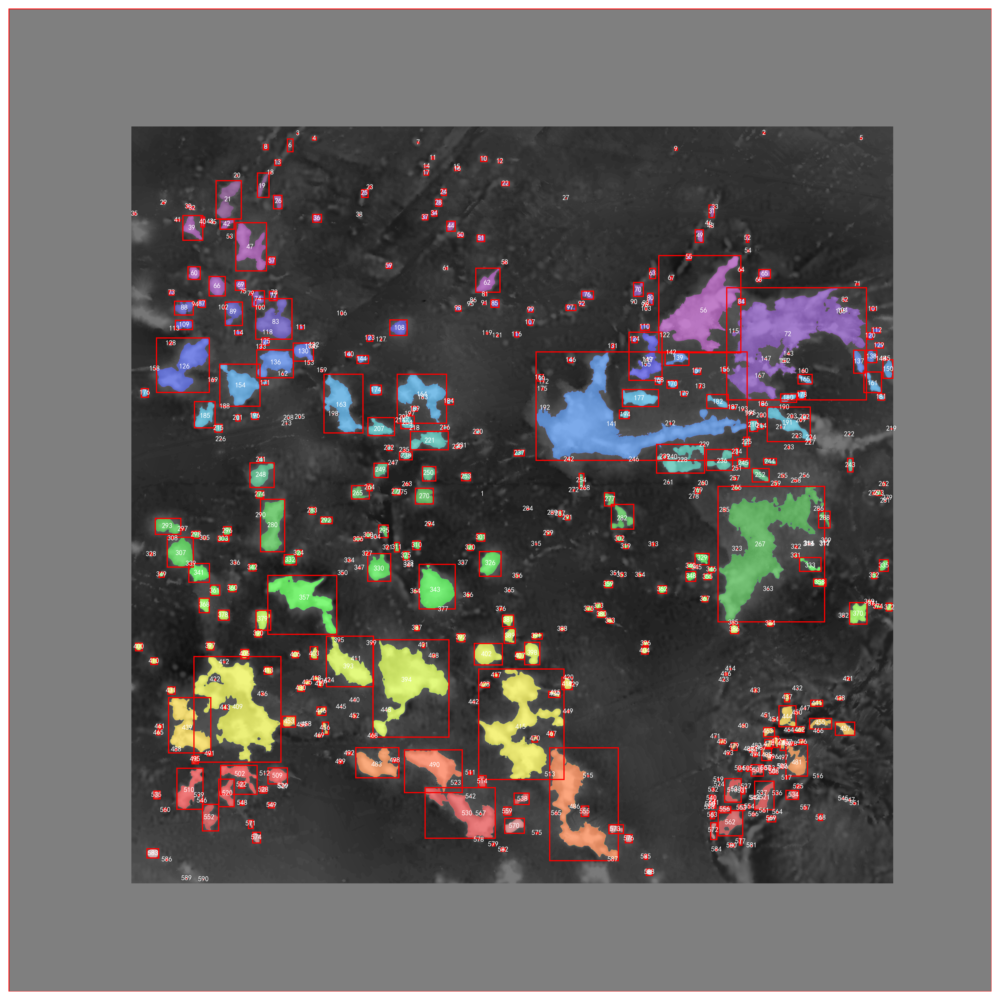

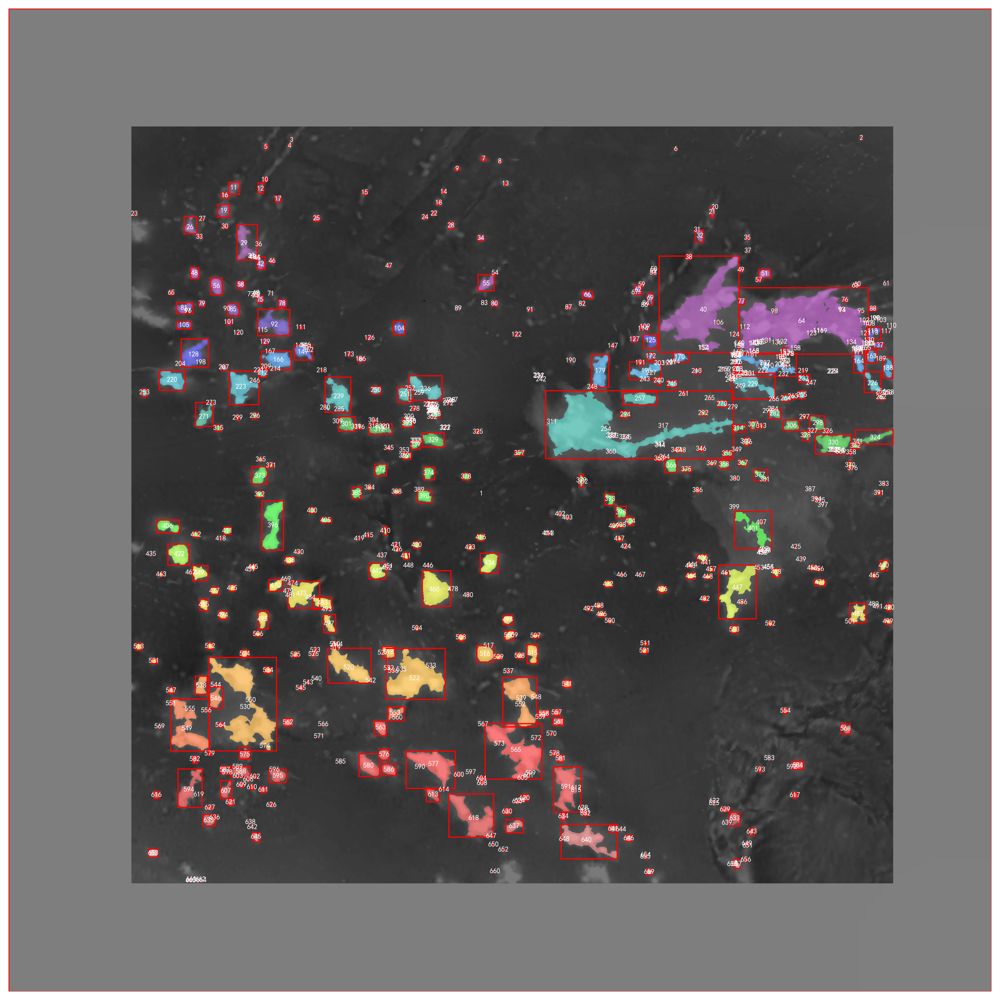

In [72]:
from skimage import measure, filters
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

# Apply a Gaussian blur to the image to reduce noise and improve edge detection
blurred_image = filters.gaussian(image_eq, sigma=1.0)       #1000,1000
print(image_eq.shape)   #1000,1000
# Use a threshold to create a binary image, threshold chosen by inspecting the histogram
thresh = filters.threshold_otsu(blurred_image)
binary_image = blurred_image > thresh

# Perform connected component analysis to label the regions
labeled_image, num_features = measure.label(binary_image, background=0, return_num=True)
props = measure.regionprops(labeled_image)
# Plot the labeled image
fig, ax = plt.subplots(figsize=(15, 15),dpi=desired_dpi)
ax.imshow(image_eq_uint8, cmap='gray')  # Show the original image
ax.imshow(labeled_image, cmap='nipy_spectral', alpha=0.5)  # Overlay the labeled regions

# Annotate the regions with their corresponding labels
for prop in props:
    ax.text(
        prop.centroid[1], prop.centroid[0], str(prop.label),
        horizontalalignment='center',
        verticalalignment='center',
        fontsize=6, color='white'
    )
    # Draw the bounding box
    minr, minc, maxr, maxc = prop.bbox
    rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                              fill=False, edgecolor='red', linewidth=1)
    ax.add_patch(rect)
ax.axis('off')
plt.show()

from skimage import exposure
# Reapplying adaptive histogram equalization with a lower clip limit to enhance contrast
image_eq_enhanced = exposure.equalize_adapthist(image_gray, clip_limit=0.01)

# Convert the enhanced image back to uint8 format
image_eq_enhanced_uint8 = (image_eq_enhanced * 255).astype(np.uint8)

# Use a threshold to create a binary image, threshold chosen by inspecting the histogram
thresh_enhanced = filters.threshold_otsu(image_eq_enhanced_uint8)
binary_image_enhanced = image_eq_enhanced_uint8 > thresh_enhanced

# Perform connected component analysis to label the regions
labeled_image_enhanced, num_features_enhanced = measure.label(binary_image_enhanced, background=0, return_num=True)
props_enhanced = measure.regionprops(labeled_image_enhanced)

# Plot the labeled image with bounding boxes around the highlighted areas
fig, ax = plt.subplots(figsize=(15, 15),dpi=desired_dpi)
ax.imshow(image_eq_enhanced_uint8, cmap='gray')  # Show the enhanced contrast image
ax.imshow(labeled_image_enhanced, cmap='nipy_spectral', alpha=0.5)  # Overlay the labeled regions
# Draw the bounding boxes in red
for prop in props_enhanced:
    ax.text(
    prop.centroid[1], prop.centroid[0], str(prop.label),
    horizontalalignment='center',
    verticalalignment='center',
    fontsize=6, color='white'
    )
    minr, minc, maxr, maxc = prop.bbox
    rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                              fill=False, edgecolor='red', linewidth=1)
    ax.add_patch(rect)

ax.axis('off')
plt.show()

In [ ]:
from skimage import measure, filters, util
import matplotlib.pyplot as plt
import numpy as np
# 设置放大因子
zoom_factor = 2

# 遍历每个连通区域
for prop in props_enhanced:
    # 获取区域的中心坐标
    cy, cx = prop.centroid

    # 定义放大区域的大小
    half_size = zoom_factor * max(prop.bbox[2] - prop.bbox[0], prop.bbox[3] - prop.bbox[1]) // 2

    # 计算放大区域的边界
    min_row = int(max(cy - half_size, 0))
    max_row = int(min(cy + half_size, image_eq.shape[0]))
    min_col = int(max(cx - half_size, 0))
    max_col = int(min(cx + half_size, image_eq.shape[1]))

    # 提取并放大区域
    zoomed_region = image[min_row:max_row, min_col:max_col]
    # 如果数据类型不是 uint8 或者值范围不在 [0, 255]，则进行转换
    if image_eq.dtype != np.uint8 or image_eq.min() < 0 or image_eq.max() > 255:
        image_eq_uint8 = ((image_eq - image_eq.min()) / (image_eq.max() - image_eq.min()) * 255).astype(np.uint8)
    else:
        image_eq_uint8 = image_eq

    # 显示或保存放大后的区域
    fig, ax = plt.subplots(dpi=desired_dpi)
    ax.imshow(zoomed_region, cmap='gray')
    ax.set_title(f'Zoomed Region Around Object {prop.label}')
    ax.axis('off')
    plt.show()

    # 如果需要，也可以保存图像
    # plt.imsave(f'zoomed_region_{prop.label}.png', zoomed_region, cmap='gray')

In [ ]:
import matplotlib.colors as mcolors

def map_coords_to_nc(image_coord, image_dims, nc_dims):
    """
    将图像坐标映射到 NetCDF 数据坐标。

    参数:
    - image_coord: 图像坐标 (y, x)。
    - image_dims: 图像的尺寸 (高度, 宽度)。
    - nc_dims: NetCDF 数据的尺寸 (纬度长度, 经度长度)。

    返回:
    - NetCDF 数据中对应的坐标 (y, x)。
    """
    y_ratio = nc_dims[0] / image_dims[0]
    x_ratio = nc_dims[1] / image_dims[1]
    
    nc_y = int(image_coord[0] * y_ratio)
    nc_x = int(image_coord[1] * x_ratio)

    return nc_y, nc_x
def create_custom_colormap(vmin, vmax):
    """
    创建一个自定义的色标，0的位置显示为白色，负值为蓝色，正值为红色。

    参数:
    - vmin: 数据的最小值。
    - vmax: 数据的最大值。
    """
    zero_norm = (0 - vmin) / (vmax - vmin)  # 0值在归一化色标中的位置
    colors = [(0, "blue"), (zero_norm, "white"), (1, "red")]
    cmap_name = 'customCmap'

    # 创建颜色映射对象
    cm = mcolors.LinearSegmentedColormap.from_list(cmap_name, colors)
    return cm

zoom_factor = 1.5 # 增加放大因子
min_zoom_size = 100 # 增大最小放大尺寸
max_zoom_size = 300  # 增大最大放大尺寸
# 假设 'image_eq_uint8' 是处理后的图像
image_dims = image_eq_uint8.shape[:2]  # (高度, 宽度)
# 从 NetCDF 数据中获取维度
nc_dims = da.shape  # (纬度长度, 经度长度)
global_min = da.min()
global_max = da.max()
custom_cmap = create_custom_colormap(global_min, global_max)
for prop in props:
    # 获取连通域的边界框尺寸
    bbox_height = prop.bbox[2] - prop.bbox[0]
    bbox_width = prop.bbox[3] - prop.bbox[1]
    # 确定放大区域的尺寸
    zoom_height = max(min_zoom_size, min(max_zoom_size, bbox_height * zoom_factor))
    zoom_width = max(min_zoom_size, min(max_zoom_size, bbox_width * zoom_factor))
    # 计算放大区域的中心坐标
    nc_y, nc_x = map_coords_to_nc(prop.centroid, image_dims, nc_dims)
    # 计算放大区域的边界
    min_lat = max(int(nc_y - zoom_height // 2), 0)
    max_lat = min(int(nc_y + zoom_height // 2), da.shape[0])
    min_lon = max(int(nc_x - zoom_width // 2), 0)
    max_lon = min(int(nc_x + zoom_width // 2), da.shape[1])
    # 提取放大区域
    zoomed_region = da.isel(lat=slice(min_lat, max_lat), lon=slice(min_lon, max_lon))
    for zoomed_region in [zoomed_region]:  # 这里是一个列表，可以包含多个区域
        if zoomed_region.size > 0:
            plt.figure(figsize=(12, 10))  # 增加图像尺寸
            im = zoomed_region.plot(cmap=custom_cmap, vmin=global_min, vmax=global_max, add_colorbar=True)  # 使用自定义色标
            plt.title(f'Zoomed Region Around Object {prop.label}')
            plt.xlabel('Longitude')
            plt.ylabel('Latitude')
            plt.show()

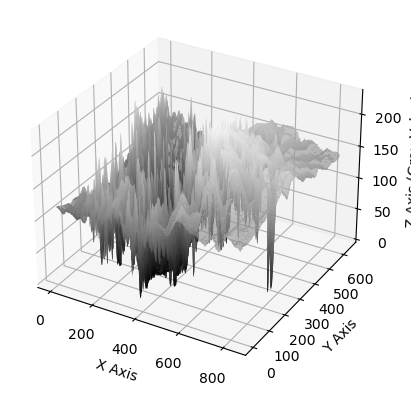

In [5]:
import numpy as np
from matplotlib import pyplot as plt
import cv2 as cv
import os

class Plot3DImage(object):
    def __init__(self, path_of_image):
        self.path_of_image = path_of_image  # Reading the image path
        self.img = cv.imread(self.path_of_image, cv.IMREAD_GRAYSCALE)  # Reading the image as grayscale

    def plot_img(self):
        if self.img is not None:
            rows, cols = self.img.shape
            # 创建x, y坐标网格
            x = np.linspace(0, cols - 1, cols)
            y = np.linspace(0, rows - 1, rows)
            x, y = np.meshgrid(x, y)
            # 创建3D图形
            fig = plt.figure()
            ax = fig.add_subplot(111, projection='3d')
            # 使用灰度值作为高度z
            z = self.img
            # 绘制3D图形
            ax.plot_surface(x, y, z,rstride = 1, cstride = 1, cmap='gray')
            # 设置轴标签
            ax.set_xlabel('X Axis')
            ax.set_ylabel('Y Axis')
            ax.set_zlabel('Z Axis (Gray Value)')
            # 启用交互模式
            plt.ion()
            # 显示图形
            plt.show()

if __name__ == '__main__':
    path = os.path.join('..', 'data', 'area_test.jpg')
    plotter = Plot3DImage(path)
    plotter.plot_img()


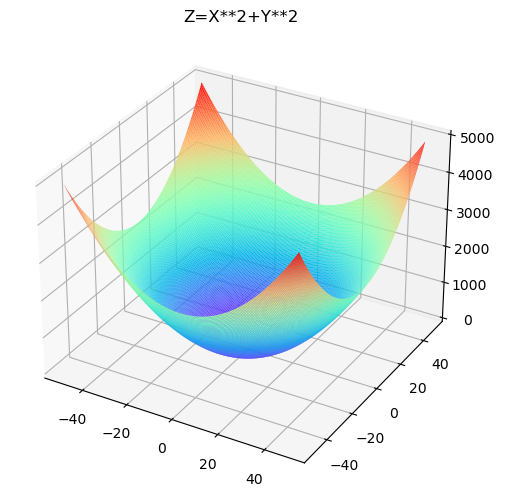

In [6]:
import numpy as np
from matplotlib import pyplot as plt
#from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(8,6)) 
ax = plt.axes(projection='3d')

x = np.arange(-50,50,0.5) #x定义域，离散
y = np.arange(-50,50,0.5) #y定义域，离散
X, Y = np.meshgrid(x, y)

Z=X**2+Y**2#需要换图形就改这里
plt.title('Z=X**2+Y**2')#添加标题

ax.plot_surface(X,Y,Z,rstride = 1, cstride = 1,cmap='rainbow')
plt.show()
